In [117]:
%load_ext autoreload
%autoreload 2
from dpe import DPE
from lib_data import *
import matplotlib.pyplot as plt
import numpy as np
from lib_nn_dpe import NN_dpe
from IPython import display

import serial
%config InlineBackend.figure_formats = ['svg']

import matplotlib
matplotlib.rcParams['font.sans-serif'] = "Arial"

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [3]:
dpe = DPE('COM6')
dpe.set_clock(50)
dpe.shape

DAC initialized to a span from -10 V to 10 V
Setting vrefs to default
Setting ADC_CK freq=50000.0kHz
Setting CK_ARRAY freq=50000.0kHz


[64, 64]

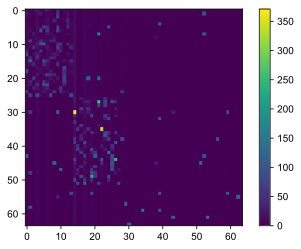

In [10]:
g = dpe.read(1, Vread=0.15,Tdly=500, method='fast')
plt.imshow(g * 1e6)
plt.colorbar()

....

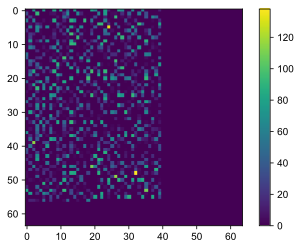

In [14]:
g = dpe.read(0,Tdly=1000, method='slow')
plt.imshow(g * 1e6)
plt.colorbar()

....

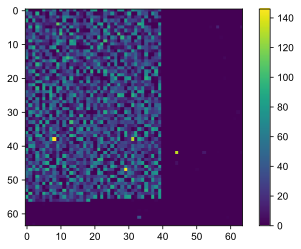

In [15]:
g = dpe.read(2,Tdly=1000, method='slow')
plt.imshow(g * 1e6)
plt.colorbar()

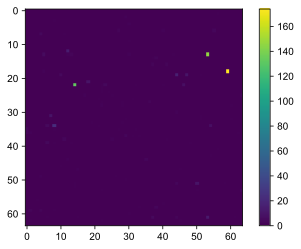

In [5]:
g = dpe.read(1, Tdly=500, method='fast')
plt.imshow(g * 1e6)
plt.colorbar()

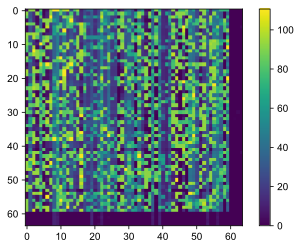

In [51]:
g = dpe.read(2, Tdly=1000, method='fast')
plt.imshow(g * 1e6)
plt.colorbar()

In [76]:
ser = serial.Serial('COM6', 9600, timeout=1)
dut.connect(ser)

In [77]:
dut.reset_chip()
dut.reset_dpe()
dut.ground_PIC()
dut.power_on()

DAC initialized to a span from -10 V to 10 V
Setting vrefs to default


In [55]:
import dut_func as dut
import serial
import time
import struct
import numpy as np
# from bitarray import bitarray
from bitstring import BitArray
import matplotlib.pyplot as plt
# %config InlineBackend.figure_formats = ['svg']
import dut_a0 as a0

from misc import *

# dut.drv.serUSB = 'COM19'
drv = dut.drv

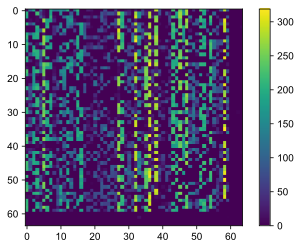

In [57]:
arr = 2
numRows = 64
numCols = 64
vRead = 0.2
vReadGate = 5.0
Vgate = 5.0
Gmap2 = np.zeros((numRows, numCols))
for rr in range(numRows):
        for cc in range(numCols):
            Gmap2[rr,cc] = 1e6*a0.pic_read_single(arr, rr, cc, gain=-1) / vRead
plt.imshow(Gmap2)
plt.colorbar()

....

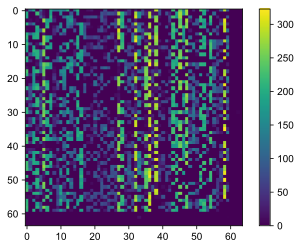

In [78]:
gslow = a0.pic_read_batch(2, Vread=0.2, gain=-1, Tdly=1000) / vRead
plt.imshow(gslow*1e6)
plt.colorbar()

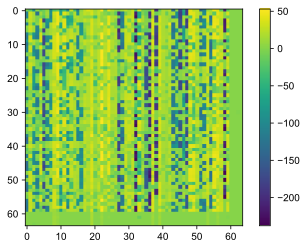

In [80]:
input = [0x1<<i for i in range(64)]
gfast = a0.pic_dpe_batch(2, input, gain=-1, Vread=0.2, Tdly=1000) / vRead
plt.imshow((gfast-gslow)*1e6)
plt.colorbar()

In [82]:
dut.disconnect()

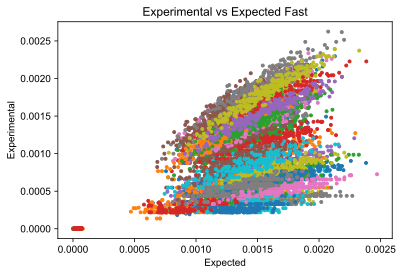

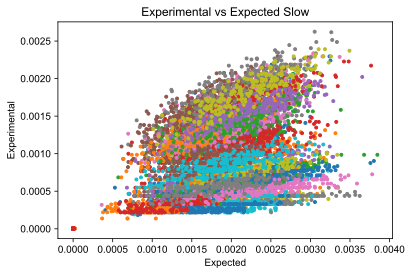

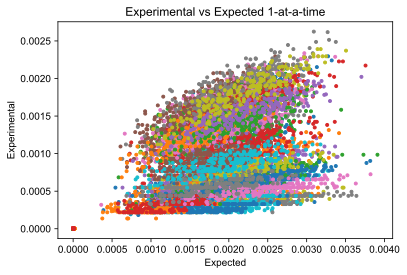

In [73]:
# Try to determine which of the array reads is more representative of what VMM operations do

arr = 2
dpe.N_BIT = 1

numTests = 100
appliedVector1 = np.zeros((64,numTests))
appliedVector2 = np.zeros((64,numTests))
randomVector = np.random.randint(2, size=(64,numTests))

appliedVector1[0:64,:] = randomVector[:,:]
appliedVector2[0:64,:] = 1-randomVector[:,:]

output1 = np.zeros((numTests,64))
output2 = np.zeros((numTests,64))
# for c in range(64):
#     output1[:,c]  = dpe.multiply(arr, appliedVector1, c_sel=[c,c+1], mode=1, debug=False, Tdly=1000).T
#     output2[:,c]  = dpe.multiply(arr, appliedVector2, c_sel=[c,c+1], mode=1, debug=False, Tdly=1000).T
output1  = dpe.multiply(arr, appliedVector1, c_sel=[0,64], mode=1, debug=False, Tdly=1000)
output2  = dpe.multiply(arr, appliedVector2, c_sel=[0,64], mode=1, debug=False, Tdly=1000)
all_output = np.concatenate((output1, output2))

expectedFastOutput1 = (gfast @ appliedVector1[0:64,:]).T 
expectedFastOutput2 = (gfast @ appliedVector2[0:64,:]).T 
all_expectedFast = np.concatenate((expectedFastOutput1, expectedFastOutput2))

expectedSlowOutput1 = (gslow @ appliedVector1[0:64,:]).T 
expectedSlowOutput2 = (gslow @ appliedVector2[0:64,:]).T 
all_expectedSlow = np.concatenate((expectedSlowOutput1, expectedSlowOutput2))

expected1AtATimeOutput1 = (Gmap2*1e-6 @ appliedVector1[0:64,:]).T 
expected1AtATimeOutput2 = (Gmap2*1e-6 @ appliedVector2[0:64,:]).T 
all_expected1AtATime= np.concatenate((expected1AtATimeOutput1, expected1AtATimeOutput2))

#error = output_corr - all_SW_output
fig, ax = plt.subplots()
plt.title('Experimental vs Expected Fast')
plt.xlabel('Expected')
plt.ylabel('Experimental')
for c in range(64):
    x = all_expectedFast[:,c]
    y = all_output[:,c]    
    ax.plot(x,y,'.')
#zz = np.linspace(0,30,30)  
#ax.plot(zz,zz,'-')

fig, ax = plt.subplots()
plt.title('Experimental vs Expected Slow')
plt.xlabel('Expected')
plt.ylabel('Experimental')
for c in range(64):
    x = all_expectedSlow[:,c]
    y = all_output[:,c]    
    ax.plot(x,y,'.')

#zz = np.linspace(0,30,30)  
#ax.plot(zz,zz,'-')

fig, ax = plt.subplots()
plt.title('Experimental vs Expected 1-at-a-time')
plt.xlabel('Expected')
plt.ylabel('Experimental')
for c in range(64):
    x = all_expected1AtATime[:,c]
    y = all_output[:,c]    
    ax.plot(x,y,'.')
#zz = np.linspace(0,30,30)  
#ax.plot(zz,zz,'-')

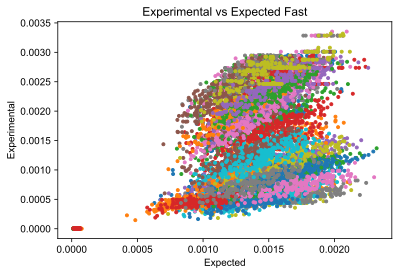

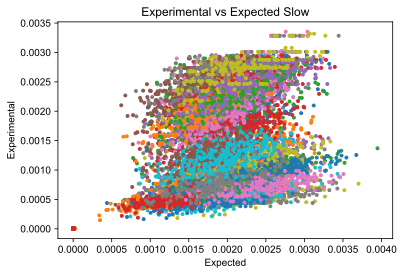

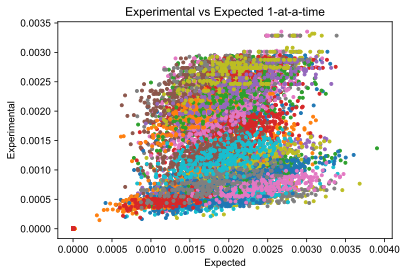

In [83]:
# Try to determine which of the array reads is more representative of what VMM operations do

arr = 2
dpe.N_BIT = 1

numTests = 100
appliedVector1 = np.zeros((64,numTests))
appliedVector2 = np.zeros((64,numTests))
randomVector = np.random.randint(2, size=(64,numTests))

appliedVector1[0:64,:] = randomVector[:,:]
appliedVector2[0:64,:] = 1-randomVector[:,:]

output1 = np.zeros((numTests,64))
output2 = np.zeros((numTests,64))
for c in range(64):
    output1[:,c]  = dpe.multiply(arr, appliedVector1, c_sel=[c,c+1], mode=1, debug=False, Tdly=1000).T
    output2[:,c]  = dpe.multiply(arr, appliedVector2, c_sel=[c,c+1], mode=1, debug=False, Tdly=1000).T
#output1  = dpe.multiply(arr, appliedVector1, c_sel=[0,64], mode=1, debug=False, Tdly=1000)
#output2  = dpe.multiply(arr, appliedVector2, c_sel=[0,64], mode=1, debug=False, Tdly=1000)
all_output = np.concatenate((output1, output2))

expectedFastOutput1 = (gfast @ appliedVector1[0:64,:]).T 
expectedFastOutput2 = (gfast @ appliedVector2[0:64,:]).T 
all_expectedFast = np.concatenate((expectedFastOutput1, expectedFastOutput2))

expectedSlowOutput1 = (gslow @ appliedVector1[0:64,:]).T 
expectedSlowOutput2 = (gslow @ appliedVector2[0:64,:]).T 
all_expectedSlow = np.concatenate((expectedSlowOutput1, expectedSlowOutput2))

expected1AtATimeOutput1 = (Gmap2*1e-6 @ appliedVector1[0:64,:]).T 
expected1AtATimeOutput2 = (Gmap2*1e-6 @ appliedVector2[0:64,:]).T 
all_expected1AtATime= np.concatenate((expected1AtATimeOutput1, expected1AtATimeOutput2))

#error = output_corr - all_SW_output
fig, ax = plt.subplots()
plt.title('Experimental vs Expected Fast')
plt.xlabel('Expected')
plt.ylabel('Experimental')
for c in range(64):
    x = all_expectedFast[:,c]
    y = all_output[:,c]    
    ax.plot(x,y,'.')
#zz = np.linspace(0,30,30)  
#ax.plot(zz,zz,'-')

fig, ax = plt.subplots()
plt.title('Experimental vs Expected Slow')
plt.xlabel('Expected')
plt.ylabel('Experimental')
for c in range(64):
    x = all_expectedSlow[:,c]
    y = all_output[:,c]    
    ax.plot(x,y,'.')

#zz = np.linspace(0,30,30)  
#ax.plot(zz,zz,'-')

fig, ax = plt.subplots()
plt.title('Experimental vs Expected 1-at-a-time')
plt.xlabel('Expected')
plt.ylabel('Experimental')
for c in range(64):
    x = all_expected1AtATime[:,c]
    y = all_output[:,c]    
    ax.plot(x,y,'.')
#zz = np.linspace(0,30,30)  
#ax.plot(zz,zz,'-')

Start programming, step=0, maxBound=0 yield= 0.00% - 0.00%
1.0 devices to be programmed...reset 1.0, set 0.0
Setting 0 devices...
Programming with external timing Twidth=10.000 us
Resetting 1 devices...
Programming with external timing Twidth=100.000 us
......------------------------------
Programming completed.


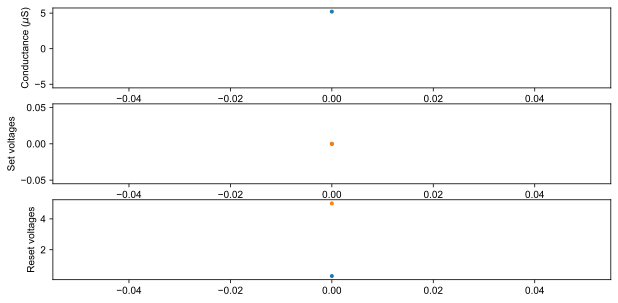

In [111]:
# Program the Hopfield Matrix in Array2, start with one device at a time
from lib_data import *
import scipy.io as sio
mat_contents = sio.loadmat('Exported60Node_GraphNum0.mat')
CMat = mat_contents['A']

CMat[0,33] = 0
CMat[33,0] = 0

GMax = 100e-6
targetG = np.zeros((64,64))
targetG[0:60,0:60] = CMat*GMax
targetG[6,56]=0

import dut_func as dut
import time
import struct
import matplotlib
import matplotlib.pyplot as plt

from dpe import DPE
from lib_data import *
from lib_nn_dpe import NN_dpe
from IPython import display
from lib_tune_g import *

arr = 2
row = 6
col = 56
dpe.N_BIT = 1
vSetRamp = [0.2, 2.6, 0.1]
vGateSetRamp = [0.3, 1.4, 0.1]
vResetRamp = [0.3, 2.5, 0.1]
vGateResetRamp = [5.0, 5.5, 0.5]
TwidthSet=10e-6
TwidthReset=100e-6
Gtol=5e-6

Msel =np.zeros((64,64))
Msel[row,col]=1


data1 = dpe.tune_conductance_old(arr, targetG, saveHistory=True, maxSteps=300, maxRetry=2, method='slow', vSetRamp = vSetRamp, 
                                     vGateSetRamp = vGateSetRamp, vResetRamp = vResetRamp, vGateResetRamp = vGateResetRamp, TwidthSet=TwidthSet, 
                                     TwidthReset=TwidthReset, Gtol=Gtol, Msel=Msel, numReads=3)

plot_history(row, col, data1)

Start programming, step=999, maxBound=1 yield= 84.35% - 84.35%
640.0 devices to be programmed...reset 14.0, set 627.0
Setting 626 devices...
Programming with external timing Twidth=10.000 us
Resetting 14 devices...
Programming with external timing Twidth=100.000 us


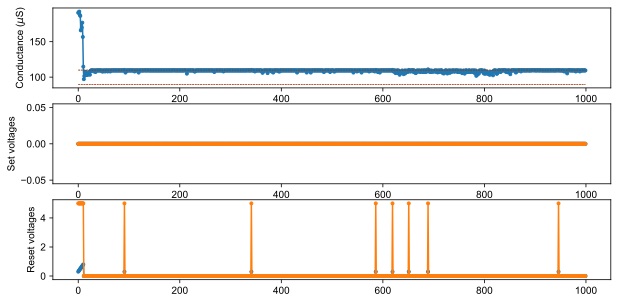

In [84]:
# Program the Hopfield Matrix in Array2 - full array
from lib_data import *
import scipy.io as sio
mat_contents = sio.loadmat('Exported60Node_GraphNum0.mat')
CMat = mat_contents['A']

CMat[0,33] = 0
CMat[33,0] = 0

GMax = 100e-6
targetG = np.zeros((64,64))
targetG[0:60,0:60] = CMat*GMax
targetG[6,56]=0

import dut_func as dut
import time
import struct
import matplotlib
import matplotlib.pyplot as plt

from dpe import DPE
from lib_data import *
from lib_nn_dpe import NN_dpe
from IPython import display
from lib_tune_g import *

arr = 2
row = 1
col = 0
dpe.N_BIT = 1
vSetRamp = [0.2, 2.8, 0.1]
vGateSetRamp = [0.3, 1.9, 0.05]
vResetRamp = [0.3, 2.9, 0.05]
vGateResetRamp = [5.0, 5.5, 0.5]
TwidthSet=10e-6
TwidthReset=100e-6
Gtol=10e-6

Msel =np.ones((64,64))



data1 = dpe.tune_conductance_old(arr, targetG, saveHistory=True, maxSteps=1000, maxRetry=2, method='slow', vSetRamp = vSetRamp, 
                                     vGateSetRamp = vGateSetRamp, vResetRamp = vResetRamp, vGateResetRamp = vGateResetRamp, TwidthSet=TwidthSet, 
                                     TwidthReset=TwidthReset, Gtol=Gtol, Msel=Msel, numReads=3)

plot_history(row, col, data1)

..

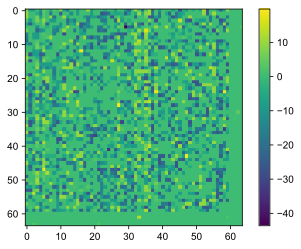

In [113]:
mat_contents = sio.loadmat('Exported60Node_GraphNum0.mat')
CMat = mat_contents['A']

CMat[0,33] = 0
CMat[33,0] = 0

GMax = 100e-6
targetG = np.zeros((64,64))
targetG[0:60,0:60] = CMat*GMax
targetG[6,56]=0
targetG[56,6]=0

g = dpe.read(2, Tdly=500, method='slow')

plt.imshow((g-targetG)*1e6)
plt.colorbar()


5.542521994134897
0.0


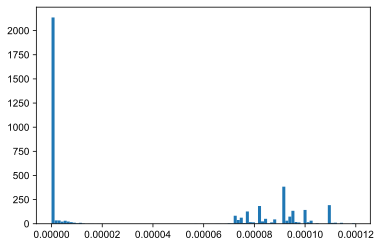

In [132]:
print(g[6,56]*1e6)
targetG[6,56]=0
print(targetG[6,56]*1e6)

ax.hist(g.flatten(),bins=100);

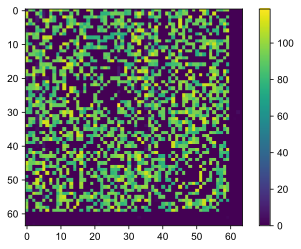

In [87]:
plt.imshow((g)*1e6)
plt.colorbar()

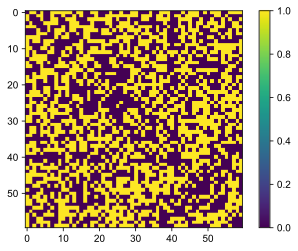

In [17]:
# Program the Hopfield Matrix in Array2, start with one device at a time
from lib_data import *
import scipy.io as sio
mat_contents = sio.loadmat('Exported60Node_GraphNum0.mat')
CMat = mat_contents['A']

CMat[0,33] = 0
CMat[33,0] = 0
plt.imshow(CMat)
plt.colorbar()

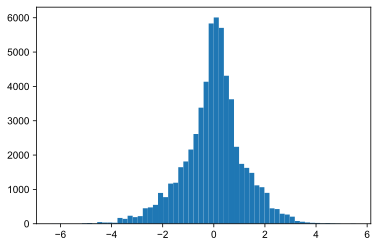

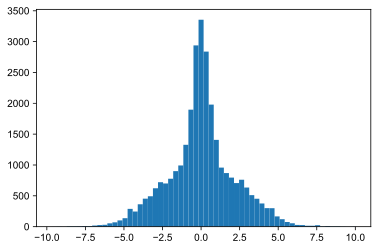

In [47]:
# NOW TRY TAKING THE DATA ONLY ONE COLUMN AT A TIME TO SEE IF WE GET BETTER ACCURACY. Linear corrections
from lib_data import *
import scipy.io as sio
mat_contents = sio.loadmat('Exported60Node_GraphNum0.mat')
CMat = mat_contents['A']

CMat[0,33] = 0
CMat[33,0] = 0

import dut_func as dut
import time
import struct
import matplotlib
import matplotlib.pyplot as plt

from dpe import DPE
from lib_data import *
from lib_nn_dpe import NN_dpe
from IPython import display

arr = 2
dpe.N_BIT = 1

numTests = 500
appliedVector1 = np.zeros((64,numTests))
appliedVector2 = np.zeros((64,numTests))
randomVector = np.random.randint(2, size=(60,numTests))

appliedVector1[0:60,:] = randomVector[:,:]
appliedVector2[0:60,:] = 1-randomVector[:,:]
neuronVector = appliedVector1[0:60,:] - appliedVector2[0:60,:]

output1 = np.zeros((numTests,60))
output2 = np.zeros((numTests,60))
for c in range(60):
    #output1[:,c]  = dpe.multiply_w_delay(arr, appliedVector1, c_sel=[c,c+1], mode=1, debug=False, delay=5).T
    output1[:,c]  = dpe.multiply(arr, appliedVector1, c_sel=[c,c+1], mode=1, debug=False, Tdly=500).T
    #output2[:,c]  = dpe.multiply_w_delay(arr, appliedVector2, c_sel=[c,c+1], mode=1, debug=False, delay=5).T
    output2[:,c]  = dpe.multiply(arr, appliedVector2, c_sel=[c,c+1], mode=1, debug=False, Tdly=500).T
all_output = np.concatenate((output1, output2))

#SW_output = neuronVector * CMat
#SW_neuron = np.matmul(neuronVector, CMat)
SW_output1 = (CMat.T @ appliedVector1[0:60,:]).T 
SW_output2 = (CMat.T @ appliedVector2[0:60,:]).T 
all_SW_output = np.concatenate((SW_output1, SW_output2))

lin_corrs = []
for c in range(60):
    lin_corrs.append( np.polyfit(all_output[:,c], all_SW_output[:,c], 1))

output_corr  = dpe.lin_corr(all_output, lin_corrs)
output_corr1 = dpe.lin_corr(output1, lin_corrs)
output_corr2 = dpe.lin_corr(output2, lin_corrs)
exp_neuron_output = output_corr1 - output_corr2
SW_neuron_output = SW_output1 - SW_output2

error = output_corr - all_SW_output
fig, ax = plt.subplots()
for c in range(60):
    x = all_SW_output[:,c]
    y = output_corr[:,c]    
    ax.plot(x,y,'.')
zz = np.linspace(0,30,30)  
ax.plot(zz,zz,'-')

fig, ax = plt.subplots()
ax.hist(error.flatten(),bins=60);

fig, ax = plt.subplots()
for c in range(60):
    x = SW_neuron_output[:,c]
    y = exp_neuron_output[:,c]    
    ax.plot(x,y,'.')   
zz = np.linspace(-25,25,50)    
ax.plot(zz,zz,'-')  

fig, ax = plt.subplots()
err_neuron = exp_neuron_output.flatten() - SW_neuron_output.flatten()
ax.hist(err_neuron.flatten(),bins=60);

In [48]:
#Run the Hopfield network with different Schmidt width values, but all at the same starting neuron vector
#Compare the results to perfect Software version.
arr = 2
numCycles = 100
numTrials = 3

startSchmidtVals = [-4.0, -2.0, -0.2, 0, 0.2, -4.0]
endSchmidtVals   = [-4.0, -2.0, -0.2, 0, 0.2, +1.0]
numSchmidt = np.size(startSchmidtVals)

SchmidtCycleVector = np.zeros((numCycles,numSchmidt))

for ss in np.arange(numSchmidt):
    SchmidtCycleVector[:,ss] = np.linspace(startSchmidtVals[ss], endSchmidtVals[ss], numCycles)
    

threshold = 0
noise = 0
numCols = 60

#energyHistory = np.zeros((numCycles*numCols+1, numTrials))
appliedVector1 = np.zeros((64,numSchmidt))
appliedVector2 = np.zeros((64,numSchmidt))

neuronVectorHistory = np.zeros((60,numSchmidt, numCycles*numCols+1, numTrials))
rawColumnOutput1History = np.zeros((1,numSchmidt, numCycles*numCols+1, numTrials))
rawColumnOutput2History = np.zeros((1,numSchmidt, numCycles*numCols+1, numTrials))
columnOutputConvertedHistory =  np.zeros((1,numSchmidt, numCycles*numCols+1, numTrials))
neuronVector = np.zeros((60,numSchmidt))
columnUpdateHistory = np.zeros((1,numCycles*numCols+1, numTrials))

for tt in np.arange(numTrials):
    print('Trial number', tt)
    randomVector = np.random.randint(2, size=(60,1))
    initVector = randomVector

    for ss in np.arange(numSchmidt):
        appliedVector1[0:60,ss] = initVector[:,0]
        appliedVector2[0:60,ss] = 1-initVector[:,0]
        neuronVector[0:60,ss] = appliedVector1[0:60,ss] - appliedVector2[0:60,ss]
        neuronVectorHistory[:,ss,0,tt] = appliedVector1[0:60,ss] - appliedVector2[0:60,ss]
        
    #energyHistory[0,tt]= 0.5*np.dot(neuronVector.T, (CMat @ neuronVector))            

    for cc in np.arange(numCycles):
        randOrderColumns = np.arange(60)
        np.random.shuffle(randOrderColumns)
        
        trackCol=0
        for ii in randOrderColumns:
            
            output1  = dpe.multiply(arr, appliedVector1, c_sel=[ii,ii+1], mode=1, debug=False, Tdly=500).T
            output2  = dpe.multiply(arr, appliedVector2, c_sel=[ii,ii+1], mode=1, debug=False, Tdly=500).T            
            #output1  = dpe.multiply_w_delay(arr, appliedVector1, c_sel=[ii, ii+1], mode=1, debug=False, delay=5)
            #output2  = dpe.multiply_w_delay(arr, appliedVector2, c_sel=[ii, ii+1], mode=1, debug=False, delay=5)
            
            output_corr = noise - dpe.lin_corr(output1, lin_corrs) + dpe.lin_corr(output2, lin_corrs)
            
            
            for ss in np.arange(numSchmidt):
                rawColumnOutput1History[0,ss,60*cc+trackCol+1,tt] = output1[0,ss]
                rawColumnOutput2History[0,ss,60*cc+trackCol+1,tt] = output2[0,ss]
                columnOutputConvertedHistory[0,ss,60*cc+trackCol+1,tt] = output_corr[0,ss]
                
                threshVector = threshold - SchmidtCycleVector[cc,ss]*neuronVector[ii,ss]
                #if (output_corr2[0,ii] >= threshVector[ii,0]):
                #if (output_corr >= threshVector[ii,0]):
                if (output_corr[0,ss] >= threshVector):
                    appliedVector1[ii,ss] = 1
                    appliedVector2[ii,ss] = 0
                    neuronVector[ii,ss] = 1
                else:
                    appliedVector1[ii,ss] = 0
                    appliedVector2[ii,ss] = 1
                    neuronVector[ii,ss] = -1
                neuronVectorHistory[:,ss,60*cc+trackCol+1,tt] = neuronVector[:,ss]
                
            columnUpdateHistory[0,60*cc+trackCol+1,tt] = ii                
            trackCol = trackCol + 1

save_workspace(vars(), note='Prober2_HNN_100cyc_3trial_VarSchmidt')

Trial number 0
Trial number 1
Trial number 2
Saving In(<class 'list'>), Out(<class 'dict'>), g(<class 'numpy.ndarray'>), mat_contents(<class 'dict'>), CMat(<class 'numpy.ndarray'>), GMax(<class 'float'>), targetG(<class 'numpy.ndarray'>), arr(<class 'int'>), row(<class 'int'>), col(<class 'int'>), vSetRamp(<class 'list'>), vGateSetRamp(<class 'list'>), vResetRamp(<class 'list'>), vGateResetRamp(<class 'list'>), TwidthSet(<class 'float'>), TwidthReset(<class 'float'>), Gtol(<class 'float'>), Msel(<class 'numpy.ndarray'>), aa(<class 'numpy.ndarray'>), Mset(<class 'numpy.ndarray'>), data1(<class 'dict'>), numCycles(<class 'int'>), numTrials(<class 'int'>), startSchmidtVals(<class 'list'>), endSchmidtVals(<class 'list'>), numSchmidt(<class 'int'>), SchmidtCycleVector(<class 'numpy.ndarray'>), threshold(<class 'int'>), noise(<class 'int'>), numCols(<class 'int'>), appliedVector1(<class 'numpy.ndarray'>), appliedVector2(<class 'numpy.ndarray'>), neuronVectorHistory(<class 'numpy.ndarray'>), 